In [ ]:
! pip install datasets transformers
! pip install accelerate==0.20.3
! pip install transformers -U

In [3]:
import sys
sys.setrecursionlimit(60000)

### Vocab

In [4]:
from transformers import AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained("bert-base-cased")

In [5]:
len(tokenizer)

28996

In [8]:
tokenizer.vocab.keys()           # type: dict()

dict_keys(['##piration', '##erty', 'consortium', '##ltry', 'deliberately', 'listed', 'specifications', '##ष', 'Studios', 'genus', '##shed', 'roller', 'break', 'terrified', '##ivate', '」', 'snaps', 'confinement', '##cht', 'provisions', 'regime', 'hurting', 'relationship', '##ez', 'Drake', 'त', 'ậ', 'Key', 'Farmers', 'Hearing', '##フ', 'transports', 'Prospect', '##vers', 'looming', 'ᵗ', 'seeing', 'localized', 'bitterly', 'rarely', '##BF', '##ʳ', 'inspire', '##ལ', 'drama', 'expertise', '##ő', '##ake', '##fying', '##uin', 'Northampton', '##nds', '##itative', 'Romania', '##quatorial', 'Active', 'Levin', 'flames', 'chains', 'ւ', 'jobs', 'combinations', '##ponents', '##む', 'succeeded', 'albeit', 'Montenegrin', '##]', 'abusive', 'regarding', '##cola', 'proved', '237', 'cases', '##cribed', 'squared', 'sits', 'exhibit', '[unused99]', 'aspect', 'ى', '##ک', '1799', 'Fairfax', 'medicinal', 'Ingram', 'projects', 'show', 'curves', 'strained', '##box', 'mice', '##jong', '##aldo', '##rel', 'gave', 'Yu',

In [9]:
import transformers
assert isinstance(tokenizer, transformers.PreTrainedTokenizerFast)

# corpus: bc2gm_corpus

### 1. Loading the corpus

In [10]:
from datasets import load_dataset, load_metric

datasets = load_dataset("bc2gm_corpus")

Extracting data files:   0%|          | 0/3 [00:00<?, ?it/s]

Generating train split:   0%|          | 0/12500 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/2500 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/5000 [00:00<?, ? examples/s]

### 2. tokens and labels of bc2gm_corpus
A few examples from the dataset were randomly selected for presentation.

The corpus is divided into three parts: id, tokens, ner_tags.
  
  Where tokens are slices of a piece of data, and each slice corresponds to a label, displayed in ner_tags.

In [11]:
from datasets import ClassLabel, Sequence
import random
import pandas as pd
from IPython.display import display, HTML

def show_random_elements(dataset, num_examples=10):
    assert num_examples <= len(dataset), "Can't pick more elements than there are in the dataset."
    picks = []
    for _ in range(num_examples):
        pick = random.randint(0, len(dataset)-1)
        while pick in picks:
            pick = random.randint(0, len(dataset)-1)
        picks.append(pick)

    df = pd.DataFrame(dataset[picks])
    for column, typ in dataset.features.items():
        if isinstance(typ, ClassLabel):
            df[column] = df[column].transform(lambda i: typ.names[i])
        elif isinstance(typ, Sequence) and isinstance(typ.feature, ClassLabel):
            df[column] = df[column].transform(lambda x: [typ.feature.names[i] for i in x])
    display(HTML(df.to_html()))

show_random_elements(datasets["train"])

,id,tokens,ner_tags
0,12426,"[There, was, a, significant, effect, of, hematocrit, on, the, General, Health, scale, on, the, SF, -, 36, (, P, =, 0, ., 03, ), .]","[O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O]"
1,2957,"[Nuclear, factor, III, (, NFIII, ), is, a, protein, from, HeLa, cells, that, stimulates, the, initiation, of, adenovirus, type, 2, (, Ad2, ), DNA, replication, by, binding, to, a, specific, nucleotide, sequence, in, the, origin, ,, adjacent, to, the, nuclear, factor, I, recognition, site, .]","[B-GENE, I-GENE, I-GENE, O, B-GENE, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, B-GENE, I-GENE, I-GENE, I-GENE, I-GENE, O]"
2,3957,"[195mPt, -, labeled, cisplatin, was, administered, iv, and, ip, to, control, mice, and, to, mice, bearing, Sarcoma, 180, .]","[O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O]"
3,11134,"[This, intracellular, signaling, ,, known, as, the, unfolded, protein, response, (, UPR, ), ,, is, mediated, by, the, cis, -, acting, ER, stress, response, element, (, ERSE, ), in, mammals, .]","[O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O]"
4,1819,"[Evidence, that, therapeutic, alterations, of, a, circadian, rhythm, for, gastric, emptying, response, may, be, possible, .]","[O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O]"
5,4498,"[Arm, function, tests, .]","[O, O, O, O]"
6,2427,"[The, percentages, of, formed, cysts, and, growth, rates, were, monthly, estimated, and, analyzed, rhythmometrically, by, cosinor, for, 5, clonal, cultures, of, Scripsiella, trochoidea, Stein, grown, for, 2, years, under, laboratory, conditions, ,, rended, as, constant, as, possible, from, the, view, point, of, environmental, temperature, (, 24, +, /, -, 1, degree, C, ), ,, lighting, (, 25, microEin, m, -, 2, s, -, 1, ), ,, and, artificial, seawater, .]","[O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O]"
7,4833,"[The, spectrum, of, phenotypes, caused, by, these, mutations, was, strikingly, different, than, mutations, in, the, adaptor, for, the, VP16, activation, domain, .]","[O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, B-GENE, I-GENE, I-GENE, O]"
8,2118,"[Fourth, ,, sometime, between, 4, and, 24, hours, of, recovery, is, necessary, to, reverse, the, effect, of, chronic, hypoxia, on, cerebral, blood, flow, .]","[O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O, O]"
9,4245,"[Renal, and, extrarenal, arterial, fibromuscular, hyperplasia, with, hypertension, .]","[O, O, O, O, O, O, O, O, O]"


The data in training set has three labels: "0", "B-GENE", and "I-GENE"

In [12]:
label_list = datasets["train"].features[f"ner_tags"].feature.names
label_list

['O', 'B-GENE', 'I-GENE']

Calculate the number of each category in the training set

In [ ]:
n0=0    # label == 'O'
n1=0    # label == 'B-GENE'
n2=0    # label == 'I-GENE'
for i in range(len(datasets["train"]['ner_tags'])):
  if datasets["train"]['ner_tags'][i] == 0:n0+=1
  elif datasets["train"]['ner_tags'][i] == 1:n1+=1
  else:n2+=1
print(n0)
print(n1)
print(n2)

Exception ignored in: <function _xla_gc_callback at 0x7d31541c9ab0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/jax/_src/lib/__init__.py", line 97, in _xla_gc_callback
    def _xla_gc_callback(*args):
KeyboardInterrupt: 


# Tokenizer
### 1. sentence participle

In [13]:
example = 'Elevated maternal alpha fetoproteins and oligoamnios:fetal prognosis'
tokens_one = tokenizer.tokenize(example)
print(tokens_one)


['El', '##eva', '##ted', 'maternal', 'alpha', 'f', '##eto', '##p', '##rote', '##ins', 'and', 'o', '##li', '##go', '##am', '##nio', '##s', ':', 'f', '##etal', 'pro', '##gno', '##sis']


### 2. Word Sequence to Number Sequence ( Get the ids corresponding to this table )

In [14]:
ids = tokenizer.convert_tokens_to_ids(tokens_one)
print(ids)

[2896, 12853, 1906, 11476, 11164, 175, 20713, 1643, 21020, 4935, 1105, 184, 2646, 2758, 2312, 22772, 1116, 131, 175, 21470, 5250, 25566, 4863]


### 3. Number sequences to word sequences

In [15]:
sentence_one = tokenizer.decode(ids)
print(sentence_one)

Elevated maternal alpha fetoproteins and oligoamnios : fetal prognosis


### 4. Padding

In [16]:
ids_ids = tokenizer.encode(example, padding='max_length', max_length=15)
print('ids_ids', ids_ids)

ids_ids [101, 2896, 12853, 1906, 11476, 11164, 175, 20713, 1643, 21020, 4935, 1105, 184, 2646, 2758, 2312, 22772, 1116, 131, 175, 21470, 5250, 25566, 4863, 102]


### 5. Truncate

In [17]:
ids_ids2 = tokenizer.encode(example, max_length=3, truncation=True)
print('ids_ids2', ids_ids2)

ids_ids2 [101, 2896, 102]


### 6. Output format

In [18]:
tokenizer_one = tokenizer(example)
print(tokenizer_one)

{'input_ids': [101, 2896, 12853, 1906, 11476, 11164, 175, 20713, 1643, 21020, 4935, 1105, 184, 2646, 2758, 2312, 22772, 1116, 131, 175, 21470, 5250, 25566, 4863, 102], 'token_type_ids': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 'attention_mask': [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]}


# The re-segmented tokens and labels are unaligned.

The number of labels is now 9 and the number of tokens is 23.


In [19]:
example = datasets["train"][3752]
# The original tokens
print('Original tokens:     ' + str(example["tokens"]))

# Segmented tokens
tokenized_input = tokenizer(example["tokens"], is_split_into_words=True)
tokens = tokenizer.convert_ids_to_tokens(tokenized_input["input_ids"])
print('Re-segmented tokens: ' + str(tokens))

# The number of labels is now 6 and the number of tokens is 20
print('The length of the labels: ' + str(len(example[f"ner_tags"])))
print('The length of the tokens: ' + str(len(tokenized_input["input_ids"])))

Original tokens:     ['Elevated', 'maternal', 'alpha', 'fetoproteins', 'and', 'oligoamnios', ':', 'fetal', 'prognosis']
Re-segmented tokens: ['[CLS]', 'El', '##eva', '##ted', 'maternal', 'alpha', 'f', '##eto', '##p', '##rote', '##ins', 'and', 'o', '##li', '##go', '##am', '##nio', '##s', ':', 'f', '##etal', 'pro', '##gno', '##sis', '[SEP]']
The length of the labels: 9
The length of the tokens: 25


In [ ]:
tokenizer(example["tokens"], truncation=True, is_split_into_words=True)

{'input_ids': [101, 2896, 12853, 1906, 11476, 11164, 175, 20713, 1643, 21020, 4935, 1105, 184, 2646, 2758, 2312, 22772, 1116, 131, 175, 21470, 5250, 25566, 4863, 102], 'token_type_ids': [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], 'attention_mask': [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]}

### Align tokens with labels.

When aligned, tokens and labels are equal in number.

In [20]:
word_ids = tokenized_input.word_ids()
word_ids
aligned_labels = [-100 if i is None else example[f"ner_tags"][i] for i in word_ids]
print('The length of the labels: ' + str(len(aligned_labels)))
print(aligned_labels)
print('The length of the tokens: ' + str(len(tokenized_input["input_ids"])))

The length of the labels: 25
[-100, 0, 0, 0, 1, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, -100]
The length of the tokens: 25


# Data Preprocessing

1. Re-sliced
2. Align tokens with labels

preprocessor function

In [21]:
label_all_tokens = True
def tokenize_and_align_labels(examples):
    tokenized_inputs = tokenizer(examples["tokens"], truncation=True, is_split_into_words=True)

    labels = []
    for i, label in enumerate(examples[f"ner_tags"]):
        word_ids = tokenized_inputs.word_ids(batch_index=i)
        previous_word_idx = None
        label_ids = []
        for word_idx in word_ids:
            # Special tokens have a word id that is None. We set the label to -100 so they are automatically
            # ignored in the loss function.
            if word_idx is None:
                label_ids.append(-100)
            # We set the label for the first token of each word.
            elif word_idx != previous_word_idx:
                label_ids.append(label[word_idx])
            # For the other tokens in a word, we set the label to either the current label or -100, depending on
            # the label_all_tokens flag.
            else:
                label_ids.append(label[word_idx] if label_all_tokens else -100)
            previous_word_idx = word_idx

        labels.append(label_ids)

    tokenized_inputs["labels"] = labels
    return tokenized_inputs

Calling the preprocessing function

The processing is done by using the map function and applying the preprocessing function tokenize_and_align_labels (mapping) to all samples.

In [22]:
tokenized_datasets = datasets.map(tokenize_and_align_labels, batched=True)

Map:   0%|          | 0/12500 [00:00<?, ? examples/s]

Map:   0%|          | 0/2500 [00:00<?, ? examples/s]

Map:   0%|          | 0/5000 [00:00<?, ? examples/s]

The token_type_ids: Id of the participle type.

For example, if it's a sentence pair, the token belonging to the first sentence has its id set to 0, and the second sentence's is set to 1

In [ ]:
tokenized_batch_datasets['train'][1]

# Fine-tuning the model


### Define a data collator that feeds our processed data into the model

In [23]:
from transformers import DataCollatorForTokenClassification

data_collator = DataCollatorForTokenClassification(tokenizer)

### Suggestion: We should use a complete dataset

In [56]:
small_train_dataset = tokenized_datasets["train"].shuffle(seed=42).select(range(600))
small_val_dataset = tokenized_datasets["validation"].shuffle(seed=42).select(range(200))
small_test_dataset = tokenized_datasets["test"].shuffle(seed=42).select(range(200))

The data in this small training set has three labels: "0", "B-GENE", and "I-GENE"

In [55]:
label_list = small_train_dataset.features[f"ner_tags"].feature.names
label_list

['O', 'B-GENE', 'I-GENE']

Count the number of each category on a small training set

In [48]:
n0=0    # label == 'O'
n1=0    # label == 'B-GENE'
n2=0    # label == 'I-GENE'
for i in range(len(small_train_dataset['ner_tags'])):
  for j in range(len(small_train_dataset['ner_tags'][i])):
    if small_train_dataset['ner_tags'][i][j] == 0: n0+=1
    elif small_train_dataset['ner_tags'][i][j] == 1: n1+=1
    else:n2+=1
print(n0)
print(n1)
print(n2)

15658
697
940


# Training and Testing
### Load pre-trained model

In [25]:
from transformers import AutoModelForTokenClassification, TrainingArguments, Trainer

model = AutoModelForTokenClassification.from_pretrained("bert-base-cased", num_labels=3)

Some weights of BertForTokenClassification were not initialized from the model checkpoint at bert-base-cased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


### Network architecture of pre-trained model

In [ ]:
model

BertForTokenClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(28996, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e-12, el

Rewrite this function mainly to modify the final output

In [28]:
from sklearn.metrics._classification import _check_targets,precision_recall_fscore_support
from sklearn.utils.multiclass import unique_labels
import numpy as np
def classification_report_(
    y_true,
    y_pred,
    *,
    labels=None,
    target_names=None,
    sample_weight=None,
    digits=2,
    output_dict=False,
    zero_division="warn",
):
    """Build a text report showing the main classification metrics.

    Read more in the :ref:`User Guide <classification_report>`.

    Parameters
    ----------
    y_true : 1d array-like, or label indicator array / sparse matrix
        Ground truth (correct) target values.

    y_pred : 1d array-like, or label indicator array / sparse matrix
        Estimated targets as returned by a classifier.

    labels : array-like of shape (n_labels,), default=None
        Optional list of label indices to include in the report.

    target_names : list of str of shape (n_labels,), default=None
        Optional display names matching the labels (same order).

    sample_weight : array-like of shape (n_samples,), default=None
        Sample weights.

    digits : int, default=2
        Number of digits for formatting output floating point values.
        When ``output_dict`` is ``True``, this will be ignored and the
        returned values will not be rounded.

    output_dict : bool, default=False
        If True, return output as dict.

        .. versionadded:: 0.20

    zero_division : "warn", 0 or 1, default="warn"
        Sets the value to return when there is a zero division. If set to
        "warn", this acts as 0, but warnings are also raised.

    Returns
    -------
    report : str or dict
        Text summary of the precision, recall, F1 score for each class.
        Dictionary returned if output_dict is True. Dictionary has the
        following structure::

            {'label 1': {'precision':0.5,
                         'recall':1.0,
                         'f1-score':0.67,
                         'support':1},
             'label 2': { ... },
              ...
            }

        The reported averages include macro average (averaging the unweighted
        mean per label), weighted average (averaging the support-weighted mean
        per label), and sample average (only for multilabel classification).
        Micro average (averaging the total true positives, false negatives and
        false positives) is only shown for multi-label or multi-class
        with a subset of classes, because it corresponds to accuracy
        otherwise and would be the same for all metrics.
        See also :func:`precision_recall_fscore_support` for more details
        on averages.

        Note that in binary classification, recall of the positive class
        is also known as "sensitivity"; recall of the negative class is
        "specificity".

    See Also
    --------
    precision_recall_fscore_support: Compute precision, recall, F-measure and
        support for each class.
    confusion_matrix: Compute confusion matrix to evaluate the accuracy of a
        classification.
    multilabel_confusion_matrix: Compute a confusion matrix for each class or sample.

    Examples
    --------
    >>> from sklearn.metrics import classification_report
    >>> y_true = [0, 1, 2, 2, 2]
    >>> y_pred = [0, 0, 2, 2, 1]
    >>> target_names = ['class 0', 'class 1', 'class 2']
    >>> print(classification_report(y_true, y_pred, target_names=target_names))
                  precision    recall  f1-score   support
    <BLANKLINE>
         class 0       0.50      1.00      0.67         1
         class 1       0.00      0.00      0.00         1
         class 2       1.00      0.67      0.80         3
    <BLANKLINE>
        accuracy                           0.60         5
       macro avg       0.50      0.56      0.49         5
    weighted avg       0.70      0.60      0.61         5
    <BLANKLINE>
    >>> y_pred = [1, 1, 0]
    >>> y_true = [1, 1, 1]
    >>> print(classification_report(y_true, y_pred, labels=[1, 2, 3]))
                  precision    recall  f1-score   support
    <BLANKLINE>
               1       1.00      0.67      0.80         3
               2       0.00      0.00      0.00         0
               3       0.00      0.00      0.00         0
    <BLANKLINE>
       micro avg       1.00      0.67      0.80         3
       macro avg       0.33      0.22      0.27         3
    weighted avg       1.00      0.67      0.80         3
    <BLANKLINE>
    """

    y_type, y_true, y_pred = _check_targets(y_true, y_pred)

    if labels is None:
        labels = unique_labels(y_true, y_pred)
        labels_given = False
    else:
        labels = np.asarray(labels)
        labels_given = True

    # labelled micro average
    micro_is_accuracy = (y_type == "multiclass" or y_type == "binary") and (
        not labels_given or (set(labels) == set(unique_labels(y_true, y_pred)))
    )

    if target_names is not None and len(labels) != len(target_names):
        if labels_given:
            warnings.warn(
                "labels size, {0}, does not match size of target_names, {1}".format(
                    len(labels), len(target_names)
                )
            )
        else:
            raise ValueError(
                "Number of classes, {0}, does not match size of "
                "target_names, {1}. Try specifying the labels "
                "parameter".format(len(labels), len(target_names))
            )
    if target_names is None:
        target_names = ["%s" % l for l in labels]

    headers = ["precision", "recall", "f1-score", "support"]
    # compute per-class results without averaging
    p, r, f1, s = precision_recall_fscore_support(
        y_true,
        y_pred,
        labels=labels,
        average=None,
        sample_weight=sample_weight,
        zero_division=zero_division,
    )
    return p, r, f1, s

In [29]:
import numpy as np
from sklearn.metrics import balanced_accuracy_score,precision_recall_fscore_support
from sklearn.preprocessing import MultiLabelBinarizer
# from sklearn.metrics import average_precision_score

def compute_metrics(p):
    predictions, labels = p
    predictions = np.argmax(predictions, axis=2)

    # Remove ignored index (special tokens)
    true_predictions = [
        [label_list[p] for (p, l) in zip(prediction, label) if l != -100]
        for prediction, label in zip(predictions, labels)
    ]
    true_labels = [
        [label_list[l] for (p, l) in zip(prediction, label) if l != -100]
        for prediction, label in zip(predictions, labels)
    ]
    x = []
    y = []
    for i in range(len(true_predictions)):
      x += true_predictions[i]
    for j in range(len(true_labels)):
      y += true_labels[j]

    accuracy = balanced_accuracy_score(y, x)
    label_dict = ['I-GENE','B-GENE','O']
    p,r,f1,s = classification_report_(y, x, target_names=label_dict, digits=4)


    return {
        "labels": label_dict,
        "precision": p,
        "recall": r,
        "f1": f1,
        "accuracy": accuracy
    }



### 1. Training parameter settings

In [30]:
args = TrainingArguments(
    f"test-ner",
    evaluation_strategy = "epoch",
    learning_rate=2e-5,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=10,
    weight_decay=0.01,
    logging_dir = 'logs',
    logging_strategy = 'steps',
    logging_first_step = True,
    logging_steps = 1
)

In [ ]:
trainer = Trainer(
    model,
    args,
    train_dataset=small_train_dataset,
    eval_dataset=small_test_dataset,             # test
    data_collator=data_collator,
    optimizer = 'Adam',
    tokenizer=tokenizer,
    compute_metrics=compute_metrics
)

### pretrained model

In [ ]:
trainer.evaluate(small_test_dataset)

Trainer is attempting to log a value of "['I-GENE', 'B-GENE', 'O']" of type <class 'list'> for key "eval/labels" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.08014899 0.04310345 0.90113452]" of type <class 'numpy.ndarray'> for key "eval/precision" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.93108974 0.00866551 0.08199381]" of type <class 'numpy.ndarray'> for key "eval/recall" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.14759304 0.01443001 0.15031089]" of type <class 'numpy.ndarray'> for key "eval/f1" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.


{'eval_loss': 1.273084282875061,
 'eval_labels': ['I-GENE', 'B-GENE', 'O'],
 'eval_precision': array([0.08014899, 0.04310345, 0.90113452]),
 'eval_recall': array([0.93108974, 0.00866551, 0.08199381]),
 'eval_f1': array([0.14759304, 0.01443001, 0.15031089]),
 'eval_accuracy': 0.3405830203593931,
 'eval_runtime': 65.5324,
 'eval_samples_per_second': 3.052,
 'eval_steps_per_second': 0.198}

### 2. Fine-tuning on pre-trained model

In [ ]:
len(tokenizer)

28996

In [ ]:
n0=0
n1=0
n2=0
# len(small_train_dataset[0]['ner_tags'])
# len(small_train_dataset)
for i in range(len(small_train_dataset)):
  for j in range(len(small_train_dataset[i]['labels'])):
    if small_train_dataset[i]['labels'][j] == 0:n0+=1
    elif small_train_dataset[i]['labels'][j] == 1:n1+=1
    elif small_train_dataset[i]['labels'][j] == 2:n2+=1
print(n0)
print(n1)
print(n2)
max_label = max(n0,n1,n2)
print(max_label)
weights = [max_label/n0, max_label/n1, max_label/n2]
print(weights)

20341
1820
1479
20341
[1.0, 11.176373626373627, 13.753211629479377]


In [ ]:
from torch import nn
from transformers import Trainer


class CustomTrainer(Trainer):
    def compute_loss(self, model, inputs, return_outputs=False):
        labels = inputs.pop("labels")
        # forward pass
        outputs = model(**inputs)
        logits = outputs.get("logits")
        # compute custom loss (suppose one has 3 labels with different weights)
        weights = [max_label/n0, max_label/n1, max_label/n2]
        print(weights)
        class_weights = torch.FloatTensor(weights).to(device)
        loss_fct = nn.CrossEntropyLoss(weight=class_weights, device=model.device)
        # loss_fct = nn.CrossEntropyLoss(weight=torch.tensor([1.0, 2.0, 3.0], device=model.device))
        loss = loss_fct(logits.view(-1, self.model.config.num_labels), labels.view(-1))
        return (loss, outputs) if return_outputs else loss

In [ ]:
trainer = Trainer(
    model,
    args,
    train_dataset=small_train_dataset,
    eval_dataset=small_val_dataset,             # validation
    data_collator=data_collator,
    tokenizer=tokenizer,
    compute_metrics=compute_metrics
)

In [ ]:
trainer.train()

Epoch,Training Loss,Validation Loss,Labels,Precision,Recall,F1,Accuracy
1,0.202900,0.208621,"['I-GENE', 'B-GENE', 'O']",[0.69306931 0.62857143 0.96343991],[0.79416532 0.42409639 0.96990016],[0.74018127 0.50647482 0.96665924],0.729387
2,0.014300,0.176031,"['I-GENE', 'B-GENE', 'O']",[0.80188679 0.80088496 0.95248318],[0.68881686 0.43614458 0.99165549],[0.74106364 0.56474259 0.9716747 ],0.705539
3,0.123000,0.142470,"['I-GENE', 'B-GENE', 'O']",[0.77443609 0.75522388 0.97582678],[0.83468395 0.60963855 0.98047981],[0.80343214 0.67466667 0.97814776],0.808267
4,0.083800,0.144236,"['I-GENE', 'B-GENE', 'O']",[0.79773463 0.78125 0.97327624],[0.79902755 0.6626506 0.98226792],[0.79838057 0.71707953 0.97775141],0.814649
5,0.023800,0.152386,"['I-GENE', 'B-GENE', 'O']",[0.78931751 0.73707865 0.98429952],[0.86223663 0.79036145 0.97153926],[0.82416731 0.7627907 0.97787777],0.874712
6,0.020700,0.163103,"['I-GENE', 'B-GENE', 'O']",[0.77973568 0.74876847 0.98121995],[0.86061588 0.73253012 0.97317836],[0.81818182 0.74056029 0.97718261],0.855441
7,0.020100,0.166848,"['I-GENE', 'B-GENE', 'O']",[0.78931751 0.74939173 0.98122559],[0.86223663 0.74216867 0.97347638],[0.82416731 0.74576271 0.97733563],0.859294
8,0.013000,0.173805,"['I-GENE', 'B-GENE', 'O']",[0.8 0.75348837 0.98374229],[0.86871961 0.78072289 0.9737744 ],[0.83294483 0.76686391 0.97873296],0.874406
9,0.002800,0.187010,"['I-GENE', 'B-GENE', 'O']",[0.77683616 0.73951435 0.98678213],[0.89141005 0.80722892 0.96781404],[0.83018868 0.7718894 0.97720605],0.888818
10,0.007400,0.185440,"['I-GENE', 'B-GENE', 'O']",[0.7776204 0.76122931 0.98457817],[0.8897893 0.77590361 0.97034719],[0.82993197 0.76849642 0.97741088],0.878680


Trainer is attempting to log a value of "['I-GENE', 'B-GENE', 'O']" of type <class 'list'> for key "eval/labels" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.69306931 0.62857143 0.96343991]" of type <class 'numpy.ndarray'> for key "eval/precision" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.79416532 0.42409639 0.96990016]" of type <class 'numpy.ndarray'> for key "eval/recall" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.74018127 0.50647482 0.96665924]" of type <class 'numpy.ndarray'> for key "eval/f1" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "['I-GENE', 'B-GENE

TrainOutput(global_step=380, training_loss=0.09916515048734206, metrics={'train_runtime': 5901.5466, 'train_samples_per_second': 1.017, 'train_steps_per_second': 0.064, 'total_flos': 256522244582880.0, 'train_loss': 0.09916515048734206, 'epoch': 10.0})

### finetuned model

In [ ]:
trainer.evaluate(small_test_dataset)

Trainer is attempting to log a value of "['I-GENE', 'B-GENE', 'O']" of type <class 'list'> for key "eval/labels" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.78306092 0.79078695 0.97171479]" of type <class 'numpy.ndarray'> for key "eval/precision" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.84455128 0.71403813 0.97271789]" of type <class 'numpy.ndarray'> for key "eval/recall" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.81264456 0.75045537 0.97221608]" of type <class 'numpy.ndarray'> for key "eval/f1" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.


{'eval_loss': 0.2617950141429901,
 'eval_labels': ['I-GENE', 'B-GENE', 'O'],
 'eval_precision': array([0.78306092, 0.79078695, 0.97171479]),
 'eval_recall': array([0.84455128, 0.71403813, 0.97271789]),
 'eval_f1': array([0.81264456, 0.75045537, 0.97221608]),
 'eval_accuracy': 0.8437690995059753,
 'eval_runtime': 88.7625,
 'eval_samples_per_second': 2.253,
 'eval_steps_per_second': 0.146,
 'epoch': 10.0}

In [ ]:
model.save_pretrained("finetuned_model")
tokenizer.save_pretrained("finetuned_model_tokenizer")

('finetuned_model_tokenizer/tokenizer_config.json',
 'finetuned_model_tokenizer/special_tokens_map.json',
 'finetuned_model_tokenizer/vocab.txt',
 'finetuned_model_tokenizer/added_tokens.json',
 'finetuned_model_tokenizer/tokenizer.json')

### Add new gene vocabulary

### Count the positive sample (gene) vocabulary that needs to be added in the training set

In [38]:
new_tokens = set()
for item1,label in zip(small_train_dataset['tokens'],small_train_dataset['ner_tags']):
  for i,j in zip(item1,label):
    if j==1 or j==2:
      new_tokens.add(i)

In [57]:
print('The number of gene vocabulary in small training set: ' + str(len(new_tokens)))
print('Gene vocabulary: ' + str(new_tokens))

The number of gene vocabulary in small training set: 823
Gene vocabulary: {'types', 'exchange', 'cerevisiae', 'phosphoprotein', 'aminotransferase', 'SHP', 'PKA', 'HSD3B1', 'ACA', 'phosphatidylinositol', 'nonhistone', 'dehydrogenase', 'Msn4p', 'displacement', 'ribosomal', 'dependent', 'NAB', 'PKClambda', 'product', 'Rec2', 'E7', 'cytoskeleton', 'JNK', 'chloramphenicol', 'rMTM', 'BTB', 'cytosolic', 'hTAFII32', 'Engrailed', 'Gar1p', 'heavy', '11', 'hemoglobin', 'thiCOGE', 'plasmid', 'murine', 'NK1', 'RII', 'liver', 'ACTH', '80S', 'subtype', 'gp130', 'Antithrombin', 'mRNA', 'EGF', 'E2F', 'TRE', 'Rac1', 'superfamily', 'Drosophila', 'bcl', 'precursors', 'Rel', 'beta1', 'Y4', 'epoetin', 'FUT5', 'terminal', 'actin', 'Jun', 'virus', 'L10e', 'E4orf6', 'Cdc19', 'JNKs', 'VirD2', 'CPK', 'AF9', 'homology', 'paxillin', 'PLCbeta', 'beta1D', 'Krox', 'LMP', 'Igf2', 'corticotropin', 'RAD23', 'finger', 'HbO2', 'HDAg', 'regulated', 'SPP', 'PPT2', 'ctn', 'glucocorticoid', 'superoxide', 'HRAS1', 'delta', 'OR

In [41]:
a = new_tokens & tokenizer.vocab.keys()
print('Number:' + str(len(a)))
print('Words: ' + str(a))
print('Proportion: ' + str(len(a)/len(new_tokens)))

Number:203
Words: {'types', 'exchange', 'complex', 'regions', 'HP', '41', 'activated', 'amino', 'Q', '6', 'displacement', 'Anti', 'growth', 'Tax', 'dependent', 'minimal', 'product', 'transcription', 'class', 'Site', ')', 'reporter', 'factors', 'sequence', 'Na', 'ATP', 'rat', 'heavy', '11', 'L', 'liver', 'pre', 'cellular', 'immediate', 'basal', '4', 'IV', 'element', 'RNA', '20', 'proteins', 'encoding', 'inhibitor', 'B', 'chain', 'anti', 'smooth', 'G', 'plasma', 'insulin', 'bacterial', 'kinase', 'terminal', 'Jun', 'virus', 'couples', 'zinc', 'tumor', 'Human', 'PD', '(', 'colony', 'q', ',', 'Brain', 'family', 'symbol', 'motif', 'finger', 'regulated', 'regulatory', 'mutant', 'associated', 'core', 's', 'matrix', 'serum', 'like', 'delta', 'precursor', 'member', 'mouse', 'binding', 'translation', 'chicken', 'native', 'negative', 'pro', 'DNA', '-', 'IX', 'cluster', '9', 'I', '3', 'related', 'III', 'genes', 'length', '5', 'd', 'T', 'A', 'gene', 'Can', 'beta', 'IL', 'derived', 'activation', 'sit

In [42]:
b = new_tokens - tokenizer.vocab.keys()
print('Number:' + str(len(b)))
print('Words: ' + str(b))
print('Proportion: ' + str(len(b)/len(new_tokens)))

Number:620
Words: {'cerevisiae', 'phosphoprotein', 'aminotransferase', 'SHP', 'PKA', 'HSD3B1', 'ACA', 'phosphatidylinositol', 'nonhistone', 'dehydrogenase', 'Msn4p', 'ribosomal', 'NAB', 'PKClambda', 'Rec2', 'E7', 'cytoskeleton', 'JNK', 'chloramphenicol', 'rMTM', 'BTB', 'cytosolic', 'hTAFII32', 'Engrailed', 'Gar1p', 'hemoglobin', 'thiCOGE', 'plasmid', 'murine', 'NK1', 'RII', 'ACTH', '80S', 'subtype', 'gp130', 'Antithrombin', 'mRNA', 'EGF', 'E2F', 'TRE', 'Rac1', 'superfamily', 'Drosophila', 'bcl', 'precursors', 'Rel', 'beta1', 'Y4', 'epoetin', 'FUT5', 'actin', 'L10e', 'E4orf6', 'Cdc19', 'JNKs', 'VirD2', 'CPK', 'AF9', 'homology', 'paxillin', 'PLCbeta', 'beta1D', 'Krox', 'LMP', 'Igf2', 'corticotropin', 'RAD23', 'HbO2', 'HDAg', 'SPP', 'PPT2', 'ctn', 'glucocorticoid', 'superoxide', 'HRAS1', 'ORFII', 'Cdc42', 'CL100', 'HSP70', 'int', 'YccA', 'PTHrP', 'LDL', 'apolipoprotein', 'endogenous', 'homologue', 'Agrobacterium', 'SHP2', 'ICR2', 'ERK', 'furin', 'dnaK', 'phosphodiesterase', 'trolC', 'macr

In [62]:
print('【Original vocabulary】')
print('the length of the tokenizer:' + str(len(tokenizer)))
example = 'Elevated maternal alpha fetoproteins and oligoamnios:fetal prognosis' # tokenized_datasets["train"][3752]
tokens_one = tokenizer.tokenize(example)
print('Original segmentation:' + str(tokens_one))
ids = tokenizer.convert_tokens_to_ids(tokens_one)
print('ids:' + str(ids))
print('ner_tag: ' + str(tokenized_datasets["train"][3752]['ner_tags']))

【Original vocabulary】
the length of the tokenizer:28996
Original segmentation:['El', '##eva', '##ted', 'maternal', 'alpha', 'f', '##eto', '##p', '##rote', '##ins', 'and', 'o', '##li', '##go', '##am', '##nio', '##s', ':', 'f', '##etal', 'pro', '##gno', '##sis']
ids:[2896, 12853, 1906, 11476, 11164, 175, 20713, 1643, 21020, 4935, 1105, 184, 2646, 2758, 2312, 22772, 1116, 131, 175, 21470, 5250, 25566, 4863]
ner_tag: [0, 1, 2, 2, 0, 0, 0, 0, 0]


In [63]:
print('ner_tag: ' + str(tokenized_datasets["train"][3752]['ner_tags']))

ner_tag: [0, 1, 2, 2, 0, 0, 0, 0, 0]


In [76]:
tokenizer.add_tokens(list(new_tokens))

# add new, random embeddings for the new tokens
model.resize_token_embeddings(len(tokenizer))

Embedding(29616, 768)

In [56]:
print('【After adding new gene vocabulary】')
print('the length of the tokenizer:' + str(len(tokenizer)))
example = 'Elevated maternal alpha fetoproteins and oligoamnios:fetal prognosis'
tokens_one = tokenizer.tokenize(example)
print('Current segmentation:' + str(tokens_one))
ids = tokenizer.convert_tokens_to_ids(tokens_one)
print('ids:' + str(ids))

【After adding new gene vocabulary】
the length of the tokenizer:29616
Current segmentation:['E', 'le', 'v', 'a', 'te', 'd', 'maternal', 'alpha', 'fetoproteins', 'and', 'o', '##li', '##go', 'a', 'm', '##nio', 's', ':', 'f', 'eta', 'l', 'pro', 'g', 'nos', 'i', 's']
ids:[142, 5837, 191, 170, 21359, 173, 11476, 11164, 29438, 1105, 184, 2646, 2758, 170, 182, 22772, 188, 131, 175, 29600, 181, 5250, 176, 29053, 178, 188]


In [ ]:
# small_train_dataset = tokenized_datasets["train"].shuffle(seed=42).select(range(600))
# small_val_dataset = tokenized_datasets["validation"].shuffle(seed=42).select(range(200))
small_train_dataset_ = small_train_dataset.map(tokenize_and_align_labels, batched=True)
small_val_dataset_ = small_val_dataset.map(tokenize_and_align_labels, batched=True)
small_test_dataset_ = small_test_dataset.map(tokenize_and_align_labels, batched=True)

Map:   0%|          | 0/600 [00:00<?, ? examples/s]

Map:   0%|          | 0/200 [00:00<?, ? examples/s]

Map:   0%|          | 0/200 [00:00<?, ? examples/s]

In [ ]:
from transformers import DataCollatorForTokenClassification

data_collator = DataCollatorForTokenClassification(tokenizer)

In [ ]:
n0_=0
n1_=0
n2_=0
# len(small_train_dataset[0]['ner_tags'])
# len(small_train_dataset)
for i in range(len(small_train_dataset_)):
  for j in range(len(small_train_dataset_[i]['labels'])):
    if small_train_dataset_[i]['labels'][j] == 0:n0_+=1
    elif small_train_dataset_[i]['labels'][j] == 1:n1_+=1
    elif small_train_dataset_[i]['labels'][j] == 2:n2_+=1
print(n0_)
print(n1_)
print(n2_)
max_label_ = max(n0_,n1_,n2_)
print(max_label_)
weights_ = [max_label_/n0_, max_label_/n1_, max_label_/n2_]
print(weights_)

20648
707
957
20648
[1.0, 29.205091937765204, 21.575757575757574]


In [ ]:
from torch import nn
from transformers import Trainer


class CustomTrainer(Trainer):
    def compute_loss(self, model, inputs, return_outputs=False):
        labels = inputs.pop("labels")
        # forward pass
        outputs = model(**inputs)
        logits = outputs.get("logits")
        # compute custom loss (suppose one has 3 labels with different weights)
        weights_ = [max_labell_/n0_, max_labell_/n1_, max_labell_/n2_]
        print(weights_)
        class_weights = torch.FloatTensor(weights).to(device)
        loss_fct = nn.CrossEntropyLoss(weight=class_weights, device=model.device)
        # loss_fct = nn.CrossEntropyLoss(weight=torch.tensor([1.0, 2.0, 3.0], device=model.device))
        loss = loss_fct(logits.view(-1, self.model.config.num_labels), labels.view(-1))
        return (loss, outputs) if return_outputs else loss

In [ ]:
from transformers import AutoModelForTokenClassification, TrainingArguments, Trainer

model = AutoModelForTokenClassification.from_pretrained("bert-base-cased", num_labels=3)

Some weights of BertForTokenClassification were not initialized from the model checkpoint at bert-base-cased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
trainer = Trainer(
    model,
    args,
    train_dataset=small_train_dataset,
    eval_dataset=small_val_dataset,             # validation
    data_collator=data_collator,
    tokenizer=tokenizer,
    compute_metrics=compute_metrics
)

In [ ]:
trainer.train()

You're using a BertTokenizerFast tokenizer. Please note that with a fast tokenizer, using the `__call__` method is faster than using a method to encode the text followed by a call to the `pad` method to get a padded encoding.


Epoch,Training Loss,Validation Loss,Labels,Precision,Recall,F1,Accuracy
1,0.188800,0.201543,"['I-GENE', 'B-GENE', 'O']",[0.69315068 0.60512821 0.97327495],[0.82009724 0.5686747 0.96051259],[0.75129918 0.5863354 0.96685166],0.783095
2,0.017200,0.168676,"['I-GENE', 'B-GENE', 'O']",[0.82791587 0.84888889 0.95382416],[0.70178282 0.46024096 0.99418865],[0.75964912 0.596875 0.97358821],0.718737
3,0.085200,0.129281,"['I-GENE', 'B-GENE', 'O']",[0.78247734 0.80758017 0.97744138],[0.83954619 0.66746988 0.98137386],[0.81000782 0.73087071 0.97940367],0.829463
4,0.057500,0.133172,"['I-GENE', 'B-GENE', 'O']",[0.76878613 0.7675 0.98285972],[0.86223663 0.73975904 0.97407242],[0.81283422 0.75337423 0.97844634],0.858689
5,0.019800,0.147135,"['I-GENE', 'B-GENE', 'O']",[0.76890157 0.75644028 0.98533636],[0.87358185 0.77831325 0.97124125],[0.81790592 0.7672209 0.97823803],0.874379
6,0.032200,0.150581,"['I-GENE', 'B-GENE', 'O']",[0.76923077 0.78304239 0.98316549],[0.85899514 0.75662651 0.97466845],[0.81163859 0.76960784 0.97889853],0.863430
7,0.025700,0.156180,"['I-GENE', 'B-GENE', 'O']",[0.78017241 0.80687831 0.98290598],[0.88006483 0.73493976 0.97675458],[0.82711348 0.76923077 0.97982063],0.863920
8,0.004400,0.168305,"['I-GENE', 'B-GENE', 'O']",[0.79613095 0.78780488 0.98378622],[0.86709887 0.77831325 0.97645656],[0.83010085 0.7830303 0.98010769],0.873956
9,0.003600,0.174842,"['I-GENE', 'B-GENE', 'O']",[0.78347578 0.7960199 0.98538937],[0.89141005 0.77108434 0.97481746],[0.83396513 0.78335373 0.98007491],0.879104
10,0.013000,0.175445,"['I-GENE', 'B-GENE', 'O']",[0.78591954 0.78502415 0.98567767],[0.88654781 0.78313253 0.97422143],[0.8332064 0.7840772 0.97991607],0.881301


Trainer is attempting to log a value of "['I-GENE', 'B-GENE', 'O']" of type <class 'list'> for key "eval/labels" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.69315068 0.60512821 0.97327495]" of type <class 'numpy.ndarray'> for key "eval/precision" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.82009724 0.5686747  0.96051259]" of type <class 'numpy.ndarray'> for key "eval/recall" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.75129918 0.5863354  0.96685166]" of type <class 'numpy.ndarray'> for key "eval/f1" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "['I-GENE', 'B-GENE

TrainOutput(global_step=380, training_loss=0.09350761825304577, metrics={'train_runtime': 6380.5187, 'train_samples_per_second': 0.94, 'train_steps_per_second': 0.06, 'total_flos': 256522244582880.0, 'train_loss': 0.09350761825304577, 'epoch': 10.0})

### finetuned model（added words）

In [ ]:
trainer.evaluate(small_test_dataset)

Trainer is attempting to log a value of "['I-GENE', 'B-GENE', 'O']" of type <class 'list'> for key "eval/labels" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.758967   0.76792453 0.97335307]" of type <class 'numpy.ndarray'> for key "eval/precision" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.84775641 0.70537262 0.969621  ]" of type <class 'numpy.ndarray'> for key "eval/recall" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.8009084  0.73532069 0.97148345]" of type <class 'numpy.ndarray'> for key "eval/f1" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.


{'eval_loss': 0.2643708288669586,
 'eval_labels': ['I-GENE', 'B-GENE', 'O'],
 'eval_precision': array([0.758967  , 0.76792453, 0.97335307]),
 'eval_recall': array([0.84775641, 0.70537262, 0.969621  ]),
 'eval_f1': array([0.8009084 , 0.73532069, 0.97148345]),
 'eval_accuracy': 0.8409166756977805,
 'eval_runtime': 67.4669,
 'eval_samples_per_second': 2.964,
 'eval_steps_per_second': 0.193,
 'epoch': 10.0}

In [ ]:
model.save_pretrained("add_words_finetuned_model")
tokenizer.save_pretrained("add_words_finetuned_model_tokenizer")

('add_words_finetuned_model_tokenizer/tokenizer_config.json',
 'add_words_finetuned_model_tokenizer/special_tokens_map.json',
 'add_words_finetuned_model_tokenizer/vocab.txt',
 'add_words_finetuned_model_tokenizer/added_tokens.json',
 'add_words_finetuned_model_tokenizer/tokenizer.json')

### Loss

In [75]:
def parse_log_history(log_history):
    """
    Parse the `log_history` of a Trainer to get the intermediate and final evaluation results.
    """
    idx = 0
    while idx < len(log_history) and "train_runtime" not in log_history[idx]:
        idx += 1

    # If there are no training logs
    if idx == len(log_history):
        idx -= 1
        while idx >= 0 and "eval_loss" not in log_history[idx]:
            idx -= 1

        if idx >= 0:
            return None, None, log_history[idx]
        else:
            return None, None, None

    # From now one we can assume we have training logs:
    train_log = log_history[idx]
    lines = []
    training_loss = "No log"
    for i in range(idx):
        if "loss" in log_history[i]:
            training_loss = log_history[i]["loss"]
        if "eval_loss" in log_history[i]:
            metrics = log_history[i].copy()
            _ = metrics.pop("total_flos", None)
            epoch = metrics.pop("epoch", None)
            step = metrics.pop("step", None)
            _ = metrics.pop("eval_runtime", None)
            _ = metrics.pop("eval_samples_per_second", None)
            _ = metrics.pop("eval_steps_per_second", None)
            _ = metrics.pop("eval_jit_compilation_time", None)
            values = {"Training Loss": training_loss, "Epoch": epoch, "Step": step}
            for k, v in metrics.items():
                if k == "eval_loss":
                    values["Validation Loss"] = v
                else:
                    splits = k.split("_")
                    name = " ".join([part.capitalize() for part in splits[1:]])
                    values[name] = v
            lines.append(values)

    idx = len(log_history) - 1
    while idx >= 0 and "eval_loss" not in log_history[idx]:
        idx -= 1

    if idx > 0:
        eval_results = {}
        for key, value in log_history[idx].items():
            if key.startswith("eval_"):
                key = key[5:]
            if key not in ["runtime", "samples_per_second", "steps_per_second", "epoch", "step"]:
                camel_cased_key = " ".join([part.capitalize() for part in key.split("_")])
                eval_results[camel_cased_key] = value
        return train_log, lines, eval_results
    else:
        return train_log, lines, None


In [ ]:
# parse_log_history(trainer.state.log_history)

In [ ]:
# y = []
# y.append(trainer.state.log_history[37]['loss'])
# y.append(trainer.state.log_history[37+1 + 38]['loss'])
# y.append(trainer.state.log_history[37+1 + 38 + 1 + 38]['loss'])
# y.append(trainer.state.log_history[37+1 + 38 + 1 + 38 + 1 + 38]['loss'])
# y.append(trainer.state.log_history[37+1 + 38 + 1 + 38 + 1 + 38 + 1 + 38]['loss'])
# print('train loss:')
# y

In [ ]:
# y_ = []
# # trainer.state.log_history[37+1]
# y_.append(trainer.state.log_history[37+1]['eval_loss'])
# y_.append(trainer.state.log_history[37+1 + 38+1]['eval_loss'])
# y_.append(trainer.state.log_history[37+1 + 38 + 1 + 38+1]['eval_loss'])
# y_.append(trainer.state.log_history[37+1 + 38 + 1 + 38 + 1 + 38+1]['eval_loss'])
# y_.append(trainer.state.log_history[37+1 + 38 + 1 + 38 + 1 + 38 + 1 + 38+1]['eval_loss'])
# print('validation loss:')
# y_

validation loss:


[0.2788814604282379,
 0.25017857551574707,
 0.22848299145698547,
 0.22038257122039795,
 0.2192658632993698]

In [63]:

y_train_loss = [0.2029000,0.014300,0.123,0.0838,0.0238,0.0207,0.0201,0.013,0.0028,0.0074]
y_val_loss = [0.208621,0.176031,0.14247,0.144236,0.152386,0.163103,0.166848,0.173805,0.187010,0.18544]

### Draw the loss curve for training

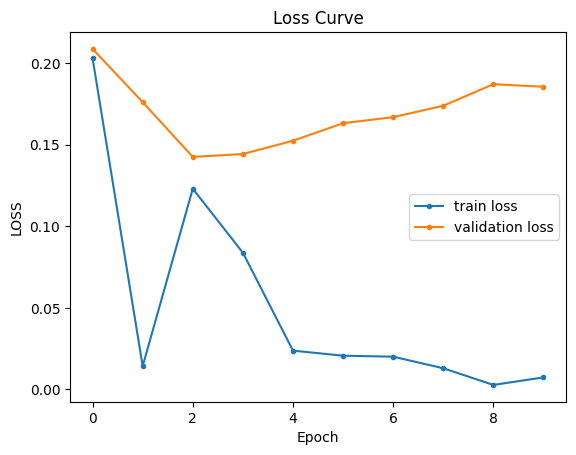

In [68]:
import matplotlib.pyplot as plt
x = range(0,len(y_val_loss))
plt.plot(x, y_train_loss, '.-')
plt.plot(x, y_val_loss, '.-')
plt_title = 'Loss Curve'
plt.title(plt_title)
plt.xlabel('Epoch')
plt.ylabel('LOSS')
plt.legend(['train loss','validation loss'])
plt.show()

# BertVis

In [80]:
! pip install bertviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 157.6/157.6 kB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.8/135.8 kB 14.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 29.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.3/11.3 MB 56.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.8/79.8 kB 7.6 MB/s eta 0:00:00


In [81]:
! pip install --upgrade urllib3

### 1. finetuned model


In [86]:
# Import specialized versions of models (that return query/key vectors)
from bertviz.transformers_neuron_view import BertModel, BertTokenizer
from bertviz.neuron_view import show

import sys
sys.setrecursionlimit(60000)

finetune_model_type = 'bert'
finetune_model_version = "/content/drive/MyDrive/add_words_finetuned_model000"
do_lower_case = False
sentence_a = "Focus on the sequence of genes"
finetune_model = BertModel.from_pretrained(finetune_model_version, output_attentions=True)
finetune_tokenizer = BertTokenizer.from_pretrained("/content/drive/MyDrive/add_words_finetuned_model_tokenizer000", do_lower_case=do_lower_case)
print('finetuned model')
show(finetune_model, finetune_model_type, finetune_tokenizer, sentence_a, sentence_a, layer=4, head=3, html_action='return')


finetuned model


### 2. pretrained model

In [83]:
from bertviz.transformers_neuron_view import BertModel, BertTokenizer
from bertviz.neuron_view import show

pretrain_model_type = 'bert'
pretrain_model_version = 'bert-base-cased'
do_lower_case = False
sentence_a = "Focus on the sequence of genes"
pretrain_model = BertModel.from_pretrained(pretrain_model_version, output_attentions=True)
pretrain_tokenizer = BertTokenizer.from_pretrained(pretrain_model_version, do_lower_case=do_lower_case)
print('pretrained model')
show(pretrain_model, pretrain_model_type, pretrain_tokenizer, sentence_a, sentence_a, layer=4, head=3, html_action='return')

pretrained model
